In [5]:
from astropy.io import fits

import jax
import jax.numpy as jnp
import matplotlib.pyplot as plt
import numpy as np

import warnings
warnings.filterwarnings("ignore")

import os
os.environ['XLA_PYTHON_CLIENT_MEM_FRACTION'] = '0.15'

jax.config.update("jax_enable_x64", True)

## Reading and Displaying Fits File

In [6]:
def process_image(image, scale_factor=1, offset=1):
    scaled_image = (image[::scale_factor, ::scale_factor])[1::, 1::]
    cropped_image = image[70:210, 70:210]
    def safe_float32_conversion(value):
        try:
            return np.float32(value)
        except (ValueError, TypeError):
            print("This value is unjaxable: " + str(value))
    fin_image = np.nan_to_num(cropped_image)
    fin_image = np.vectorize(safe_float32_conversion)(fin_image)
    return fin_image

Filename: Fits/hd111161_H_pol.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     686   ()      
  1  SCI           1 ImageHDU       140   (281, 281, 4)   float32   
  2  DQ            3 ImageHDU        64   (281, 281, 2)   uint8   


IndexError: boolean index did not match indexed array along dimension 0; dimension is 281 but corresponding boolean dimension is 140

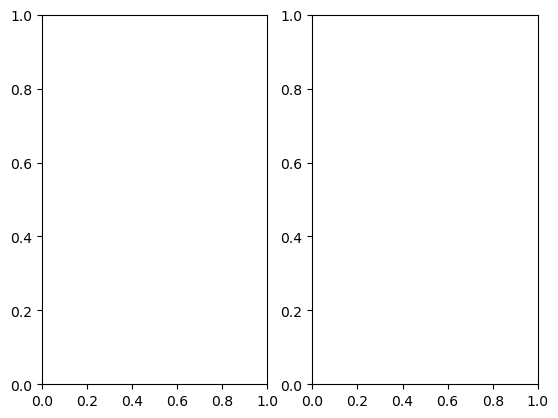

In [ ]:
fits_image_filepath = "Fits/hd111161_H_pol.fits"
hdul = fits.open(fits_image_filepath)

#Displays File Info
hdul.info()

# Gets and Displays Image
fig, axes = plt.subplots(1,2)

img = hdul['SCI'].data[1,:,:]
pimg = process_image(img)

y, x = np.indices(pimg.shape)
y -= 70
x -= 70 
rads = np.sqrt(x**2+y**2)
mask = (rads > 12)

vmin = np.percentile(pimg[mask], 1)
vmax = np.percentile(pimg[mask], 99.9)

axes[0].imshow(img)
axes[0].set_title("Original")
axes[1].imshow(pimg, origin='lower', cmap='inferno', vmin=vmin, vmax=vmax)
axes[1].set_title("Processed")
plt.suptitle("hd111161_H_pol")

## Displaying All Fits Files

In [12]:

fnames = os.listdir("Fits/")
print(fnames)

scale_factor = 1
images = []
ignore_fits = ['systempsf.fits']

for fname in fnames:
    if(fname in ignore_fits):
        continue
    hdul = fits.open("Fits/"+fname)
    image = process_image(hdul['SCI'].data[1,:,:])
    images.append(image)

['hd145560_H_pol.fits', 'hd146897_H_pol.fits', 'ceant_H_pol.fits', 'hd61005_H_pol.fits', 'systempsf.fits', 'hd111520_H_pol.fits', 'hd115600_H_pol.fits', 'hd129590_H_pol.fits', 'hd117214_H_pol.fits', 'betpic_H_pol.fits', 'hd35841_H_pol.fits', 'hd30447_H_pol.fits', 'hr7012_H_pol.fits', 'hd32297_H_pol.fits', 'hd110058_H_pol.fits', 'hd111161_H_pol.fits', 'hd157587_H_pol.fits', 'hr4796a_H_pol.fits', 'aumic_H_pol.fits', 'hd143675_H_pol.fits', 'hd131835_H_pol.fits', 'hd106906_H_pol.fits', 'hd114082_H_pol.fits', 'hd191089_H_pol.fits', 'hd156623_H_pol.fits']


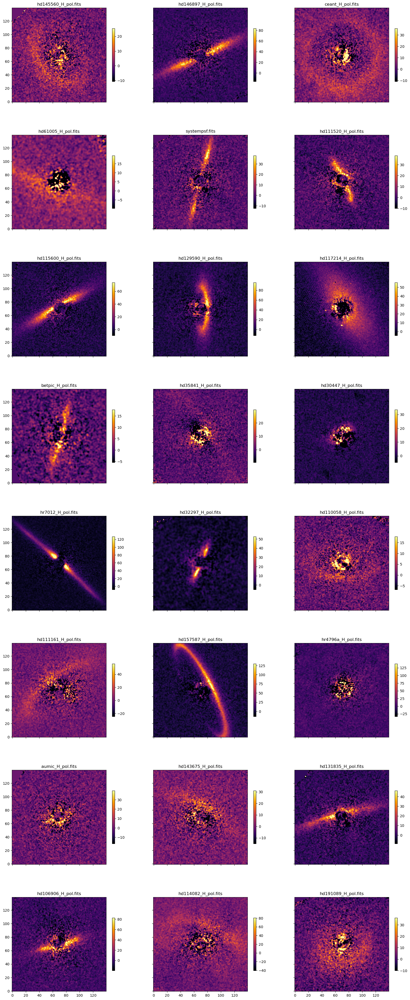

In [13]:
fig, axes = plt.subplots(8,3, sharex=True, sharey=True, figsize = (20,50))

for i in range(0, 8):
    for j in range(0, 3):

        ## Get a good scaling for the images
        y, x = np.indices(images[3*i+j].shape)
        y -= 70
        x -= 70 
        rads = np.sqrt(x**2+y**2)
        mask = (rads > 12)

        vmin = np.percentile(images[3*i+j][mask], 1)
        vmax = np.percentile(images[3*i+j][mask], 99.9)

        im = axes[i][j].imshow(images[3*i+j], origin='lower', cmap='inferno',vmin=vmin, vmax=vmax)
        axes[i][j].set_title(fnames[3*i+j])
        plt.colorbar(im,ax=axes[i][j], shrink=0.5)

## Fitting Disk Models to Fits Images

In [ ]:
from disk_utils_jax import jax_model_all_1d, jax_model
from regression import log_likelihood_1d_pos_all_pars_spline
from scipy.optimize import minimize
from SLD_utils import *

In [ ]:
# Creating error map
def create_circular_err_map(image_shape, iradius, oradius, noise_level):
    err_map = jnp.zeros(image_shape)
    center = image_shape[0]/2
    y, x = jnp.ogrid[:image_shape[0], :image_shape[1]]
    distance = jnp.sqrt((x - center) ** 2 + (y - center) ** 2)  
    err_map = jnp.where(distance <= oradius, noise_level, 1e8)
    err_map = jnp.where(distance >= iradius, err_map, 1e8)
    return err_map

## Fitting All Disks

In [ ]:
from regression import log_likelihood_image
from optimize import quick_optimize_full_opt, quick_image_full_opt, quick_optimize_cent, quick_image_cent
from datetime import datetime

def create_empirical_err_map(data, annulus_width=5, mask_rad=9, outlier_pixels=None):    
    y,x = np.indices(data.shape)
    y -= data.shape[0]//2
    x -= data.shape[1]//2 
    radii = np.sqrt(x**2 + y**2) 
    noise_array = np.zeros_like(data)
    for i in range(0, int(np.max(radii)//annulus_width) ): 
        indices = (radii > i*annulus_width) & (radii <= (i+1)*annulus_width) 
        noise_array[indices] = np.nanstd(data[indices])
    mask = radii <= mask_rad
    noise_array[mask] = 0

    if(outlier_pixels != None):
        for pixel in outlier_pixels:
            noise_array[pixel[0]][pixel[1]] = noise_array[pixel[0]][pixel[1]] * 1e6 

    return noise_array

def process_image(image, scale_factor=1, offset=1):
    scaled_image = (image[::scale_factor, ::scale_factor])[1::, 1::]
    cropped_image = image[70:210, 70:210]
    def safe_float32_conversion(value):
        try:
            return np.float32(value)
        except (ValueError, TypeError):
            print("This value is unjaxable: " + str(value))
    fin_image = np.nan_to_num(cropped_image)
    fin_image = np.vectorize(safe_float32_conversion)(fin_image)
    return fin_image

def get_inc_bounded_knots(inclination, radius, buffer = 0, num_knots=-1):
    if(num_knots <= 0):
        if(radius < 50):
            num_knots = 4
        else:
            num_knots = 6
    return jnp.linspace(jnp.cos(jnp.deg2rad(90-inclination-buffer)), jnp.cos(jnp.deg2rad(90+inclination+buffer)), num_knots)



In [ ]:
def produce_image_fit(name, target_image, err_map, radius, inclination, position_angle, distance, iters = 1000, method = None, full = False,
                      disp=False, dispTime=False, knots = None, plot = True, full_soln = False):
    opt_fun = quick_optimize_cent
    image_fun = quick_image_cent

    ## Get a good scaling
    y, x = np.indices(target_image.shape)
    y -= 70
    x -= 70 
    rads = np.sqrt(x**2+y**2)
    mask = (rads > 12)

    if (knots == None):
        knots = get_inc_bounded_knots(inclination, radius, buffer = 0)

    init_knot_guess = DoubleHenyeyGreenstein_SPF.compute_phase_function_from_cosphi([0.5, 0.5, 0.5], knots)
    init_disk_guess = jnp.array([5., -5., radius, inclination, position_angle])
    init_cent_guess = jnp.array([70., 70.])
    init_guess = None

    if(full):
        opt_fun = quick_optimize_full_opt
        image_fun = quick_image_full_opt
        distr_guess = jnp.array([0, 3, 2, 1])
        init_guess = jnp.concatenate([init_disk_guess, init_cent_guess, distr_guess, init_knot_guess])
    else:
        init_guess = jnp.concatenate([init_cent_guess, init_disk_guess, init_knot_guess])

    init_image = image_fun(init_guess, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance, knots=knots)

    if inclination > 70: 
        knot_scale = 1.*np.nanpercentile(target_image[mask], 99) / jnp.nanmax(init_image)
    else: 
        knot_scale = 0.2*np.nanpercentile(target_image[mask], 99) / jnp.nanmax(init_image)
        
    init_knot_guess = DoubleHenyeyGreenstein_SPF.compute_phase_function_from_cosphi([0.5, 0.5, 0.5], knots) * knot_scale
    init_disk_guess = jnp.array([5., -5., radius, inclination, position_angle])
    init_cent_guess = jnp.array([70., 70.])
    init_guess = None

    if(full):
        opt_fun = quick_optimize_full_opt
        image_fun = quick_image_full_opt
        distr_guess = jnp.array([0, 3, 2, 1])
        init_guess = jnp.concatenate([init_disk_guess, init_cent_guess, distr_guess, init_knot_guess])
    else:
        init_guess = jnp.concatenate([init_cent_guess, init_disk_guess, init_knot_guess])

    init_image = image_fun(init_guess, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance, knots=knots)
    init_ll = log_likelihood_image(init_image, target_image, err_map)

    # 0: alpha_in, 1: alpha_out, 2: sma, 3: inclination, 4: position_angle, 5: xc, 6: yc, 7: e, 8: ksi, 9: gamma, 10: beta
    start = datetime.now()
    soln = opt_fun(target_image, err_map, init_params=init_guess, method = method, iters = iters, PSFModel=EMP_PSF, pxInArcsec=0.01414, distance = distance, knots = knots, full_soln=True, disp=False)
    end = datetime.now()

    if(disp):
        print(soln)

    if(dispTime):
        print("Time taken: " + str(end-start))

    if plot:

        cent_image = image_fun(soln.x, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance, knots=knots)

        fig, axes = plt.subplots(2,3, figsize=(20,10))

        vmin = np.nanpercentile(target_image[mask], 1)
        vmax = np.nanpercentile(target_image[mask], 99.9)

        # Data
        im = axes[0][0].imshow(target_image, origin='lower', cmap='inferno')
        axes[0][0].set_title("Original Image")
        plt.colorbar(im, ax=axes[0][0], shrink=0.75)
        im.set_clim(vmin, vmax)

        # Error Map
        im = axes[0][1].imshow(err_map, origin='lower', cmap='inferno')
        axes[0][1].set_title("Error Map")
        plt.colorbar(im, ax=axes[0][1], shrink=0.75)
        im.set_clim(vmin, vmax)

        # Signal to Noise Ratio
        with np.errstate(divide='ignore', invalid='ignore'):  # Avoiding divide by 0 warnings
            snr = np.divide(target_image, err_map)
            snr[err_map == 0] = 0
        im = axes[0][2].imshow(snr, origin='lower', cmap='inferno')
        axes[0][2].set_title("SNR Ratio")
        plt.colorbar(im, ax=axes[0][2], shrink=0.75)
        im.set_clim(vmin, vmax)

        # Initial Guess
        im = axes[1][0].imshow(init_image, origin='lower', cmap='inferno')
        axes[1][0].set_title("Initial Guess: "+str(round(-init_ll, 2)))
        plt.colorbar(im, ax=axes[1][0], shrink=0.75)
        im.set_clim(vmin, vmax)

        # Fitted Disk
        im = axes[1][1].imshow(cent_image, origin='lower', cmap='inferno')
        axes[1][1].set_title("Fitted Disk: "+str(round(soln.fun, 2)))
        plt.colorbar(im, ax=axes[1][1], shrink=0.75)
        im.set_clim(vmin, vmax)

        # Residual of Fit to Data
        im = axes[1][2].imshow(target_image-cent_image, origin='lower', cmap='inferno')
        axes[1][2].set_title("Residual")
        plt.colorbar(im, ax=axes[1][2], shrink=0.75)
        im.set_clim(vmin, vmax)

        fig.suptitle(name + ", Convergence: " + str(soln.success))

    if full_soln:
        return soln

    return soln.x

### Loading Files

In [ ]:
import pandas as pd

image_data = pd.read_csv('image_info_filt.csv')
image_data.set_index("Name", inplace=True)
image_data.columns = ["Radius", "Inclination", "Position Angle", "Distance", "Knots"]
print(image_data)

                Radius  Inclination  Position Angle  Distance  Knots
Name                                                                
hd145560_H_pol    85.3         43.9           221.5    120.44      7
hd146897_H_pol    85.0         84.0           293.9    131.50      9
ceant_H_pol       29.8         13.1           271.0     34.03      7
hd111520_H_pol    81.0         88.0           165.0    108.94      7
hd115600_H_pol    46.0         80.0            27.5    109.62      7
hd129590_H_pol    66.9         75.7           121.7    136.04      9
hd117214_H_pol    60.2         71.0           359.8    107.61     11
hd35841_H_pol     60.3         84.9           345.8    103.68      7
hd30447_H_pol     83.0         83.0            32.3     80.54      7
hd32297_H_pol     98.4         88.4            47.9    132.79     13
hd110058_H_pol    39.0         84.0           335.0    129.98      5
hd111161_H_pol    72.4         62.1           263.2    109.43      7
hd157587_H_pol    79.0         70.

### Generate Number of Knots Needed for Each Disk Image

In [11]:
'''def get_pixels(inclination, radius, distance, pxInArcsec=0.01414):
    a = radius / distance / pxInArcsec
    b = radius / distance / pxInArcsec * jnp.cos(jnp.deg2rad(inclination))
    return jnp.pi * (3*(a+b) - jnp.sqrt((3*a+b)*(a+3*b))) / 3'''

'def get_pixels(inclination, radius, distance, pxInArcsec=0.01414):\n    a = radius / distance / pxInArcsec\n    b = radius / distance / pxInArcsec * jnp.cos(jnp.deg2rad(inclination))\n    return jnp.pi * (3*(a+b) - jnp.sqrt((3*a+b)*(a+3*b))) / 3'

In [12]:

'''name = image_data.index[18]
row = image_data.loc[name]

num_knots = int(get_pixels(row["Inclination"], row["Radius"], row["Distance"]) / 5)
if(num_knots % 2 == 0):
    num_knots -= 1'''

'''init_spf_pars = jnp.array([0.5, 0.5, 0.5])
init_disk_guess = jnp.array([5., -5., row["Radius"], row["Inclination"], row["Position Angle"]])

init_image = jax_model_all_1d(DustEllipticalDistribution2PowerLaws, DoubleHenyeyGreenstein_SPF, init_disk_guess, init_spf_pars, 1e6, PSFModel=GAUSSIAN_PSF, distance=row["Distance"])
init_image = init_image * 200 / jnp.nanmax(init_image)

noise_level = 50
noise = np.random.normal(0, noise_level, init_image.shape)

target_image = init_image + noise

err_map = create_empirical_err_map(target_image).astype(jnp.float64) #, outlier_pixels=[(57, 68)]))'''

'''hdul = fits.open("Fits/"+name+".fits")
target_image = process_image(hdul['SCI'].data[1,:,:])
err_map = process_image(create_empirical_err_map(hdul['SCI'].data[2,:,:])).astype(jnp.float64)

ind = 0
min_k = num_knots
min_val = 1e6

for i in range(num_knots, 3, -2):
    print(str(i) + " knots:")
    soln = produce_image_fit(name + ": " + str(i) + " knots", target_image, err_map, row["Radius"], row["Inclination"], row["Position Angle"], row["Distance"],
                            disp=False, iters=200, method = None, dispTime=True,
                            knots=get_inc_bounded_knots(row["Inclination"], row["Radius"], num_knots=i), plot=False, full_soln=True)
    if(soln.fun <= min_val):
        min_k = i
        min_val = soln.fun
    print("Log-Likelihood: "+str(-soln.fun))
    print("Number of Iterations: " + str(soln.nit))
    ind+=1
    print(str(ind)+" of "+str((num_knots-3)/2)+" done.\n")

print(min_k)'''

'hdul = fits.open("Fits/"+name+".fits")\ntarget_image = process_image(hdul[\'SCI\'].data[1,:,:])\nerr_map = process_image(create_empirical_err_map(hdul[\'SCI\'].data[2,:,:])).astype(jnp.float64)\n\nind = 0\nmin_k = num_knots\nmin_val = 1e6\n\nfor i in range(num_knots, 3, -2):\n    print(str(i) + " knots:")\n    soln = produce_image_fit(name + ": " + str(i) + " knots", target_image, err_map, row["Radius"], row["Inclination"], row["Position Angle"], row["Distance"],\n                            disp=False, iters=200, method = None, dispTime=True,\n                            knots=get_inc_bounded_knots(row["Inclination"], row["Radius"], num_knots=i), plot=False, full_soln=True)\n    if(soln.fun <= min_val):\n        min_k = i\n        min_val = soln.fun\n    print("Log-Likelihood: "+str(-soln.fun))\n    print("Number of Iterations: " + str(soln.nit))\n    ind+=1\n    print(str(ind)+" of "+str((num_knots-3)/2)+" done.\n")\n\nprint(min_k)'

### Testing One Disk

Radius             66.90
Inclination        75.70
Position Angle    121.70
Distance          136.04
Knots               9.00
Name: hd129590_H_pol, dtype: float64


  message: Desired error not necessarily achieved due to precision loss.
  success: False
   status: 2
      fun: 41467.58077987241
        x: [ 7.000e+01  7.000e+01 ...  5.395e-04  8.910e-04]
      nit: 5
      jac: [-2.565e+02  1.920e+02 ... -1.969e+04 -8.230e+03]
 hess_inv: [[ 1.000e+00 -5.449e-05 ...  3.677e-04 -1.144e-04]
            [-5.449e-05  1.000e+00 ...  1.535e-04  2.352e-04]
            ...
            [ 3.677e-04  1.535e-04 ...  3.257e-01 -1.948e-01]
            [-1.144e-04  2.352e-04 ... -1.948e-01  6.988e-01]]
     nfev: 656
     njev: 46
Time taken: 0:00:20.578074



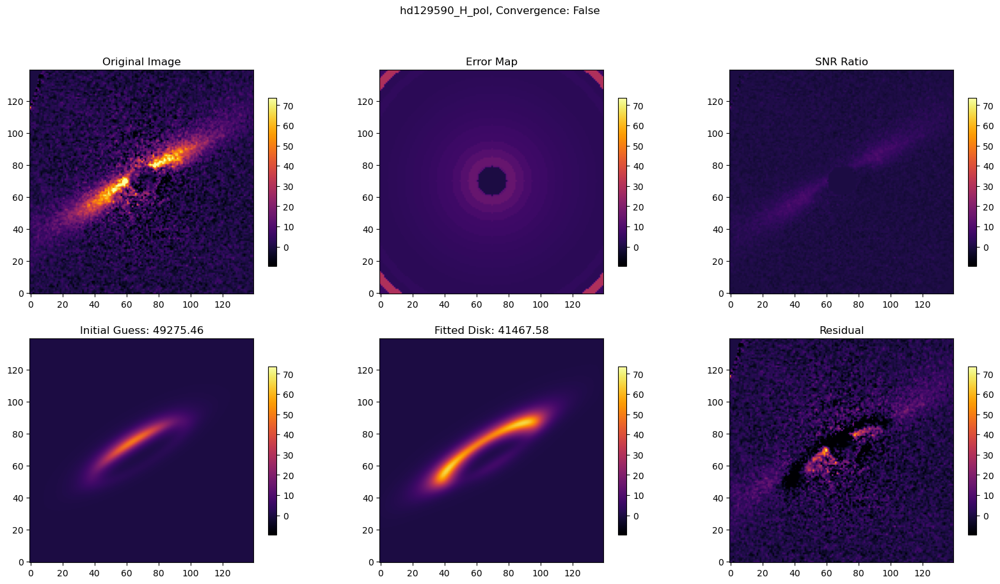

In [ ]:
#name = image_data.index[5]
name = "hd129590_H_pol"
row = image_data.loc[name]

hdul = fits.open("Fits/"+name+".fits")
target_image = process_image(hdul['SCI'].data[1,:,:])
err_map = process_image(create_empirical_err_map(hdul['SCI'].data[2,:,:])).astype(jnp.float64) #, outlier_pixels=[(57, 68)]))
print(row)
soln = produce_image_fit(name, target_image, err_map, row["Radius"], row["Inclination"], row["Position Angle"], row["Distance"],
                         disp=True, iters=1000, method = None, dispTime=True,
                         knots=get_inc_bounded_knots(row["Inclination"], row["Radius"], int(row["Knots"])))
print()
plt.savefig("FitsResults/"+name+'.png')

### Testing all Disks

Radius             85.30
Inclination        43.90
Position Angle    221.50
Distance          120.44
Knots               7.00
Name: hd145560_H_pol, dtype: float64


Time taken: 0:00:21.325157
[ 7.30003935e+01  7.18617187e+01  5.15695604e+00 -3.27383284e+00
  7.83524859e+01  4.45058615e+01  2.21499861e+02  2.72190632e-03
  2.26903855e-03  1.88996059e-03  1.66144582e-03  7.76142650e-04
  7.01803424e-04  7.25930597e-05]
1 out of 19 done

Radius             85.0
Inclination        84.0
Position Angle    293.9
Distance          131.5
Knots               9.0
Name: hd146897_H_pol, dtype: float64
Time taken: 0:00:43.597912
[ 7.17170754e+01  7.21533742e+01  2.94024521e+00 -1.77741757e+00
  6.71453748e+01  8.25955415e+01  2.94593120e+02  9.10528811e-04
  3.62516896e-03  2.35905642e-03  3.98689630e-03  2.22961883e-03
  1.47721490e-03  1.29271964e-03  1.07498709e-03 -3.87792873e-04]
2 out of 19 done

Radius             29.80
Inclination        13.10
Position Angle    271.00
Distance           34.03
Knots               7.00
Name: ceant_H_pol, dtype: float64
Time taken: 0:00:33.896188
[ 7.17853281e+01  7.23945304e+01  4.55525441e+00 -1.30906450e+00
  2.49028850

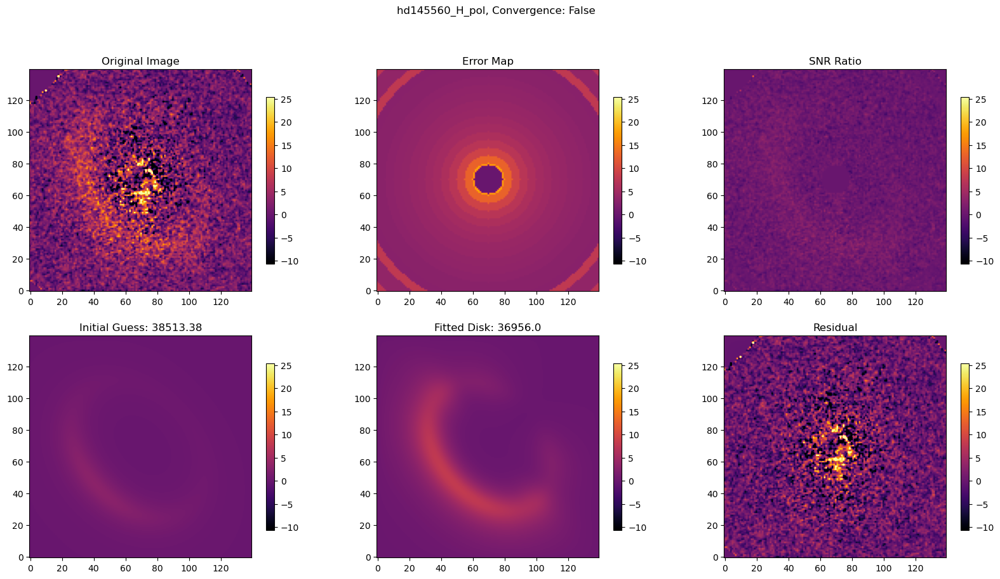

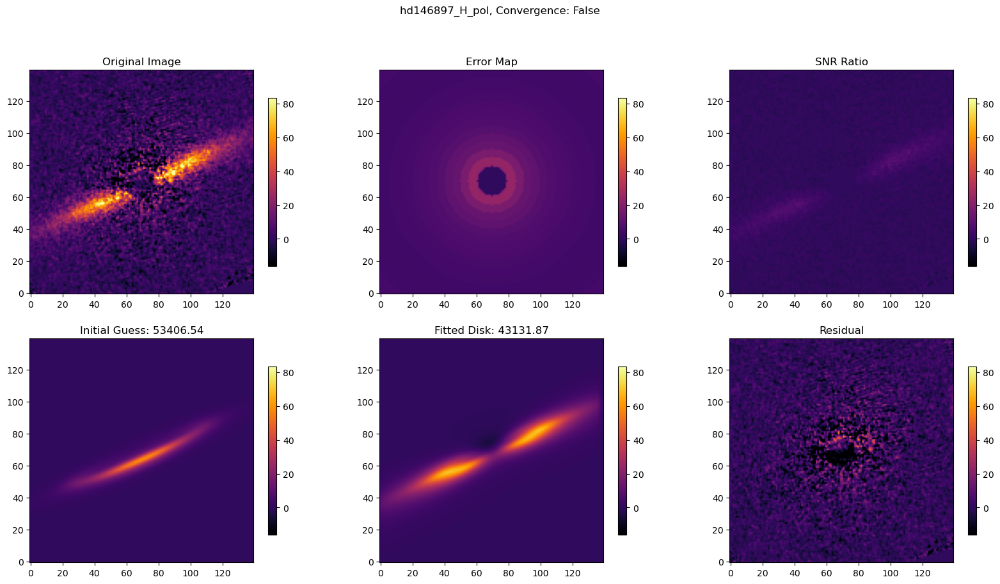

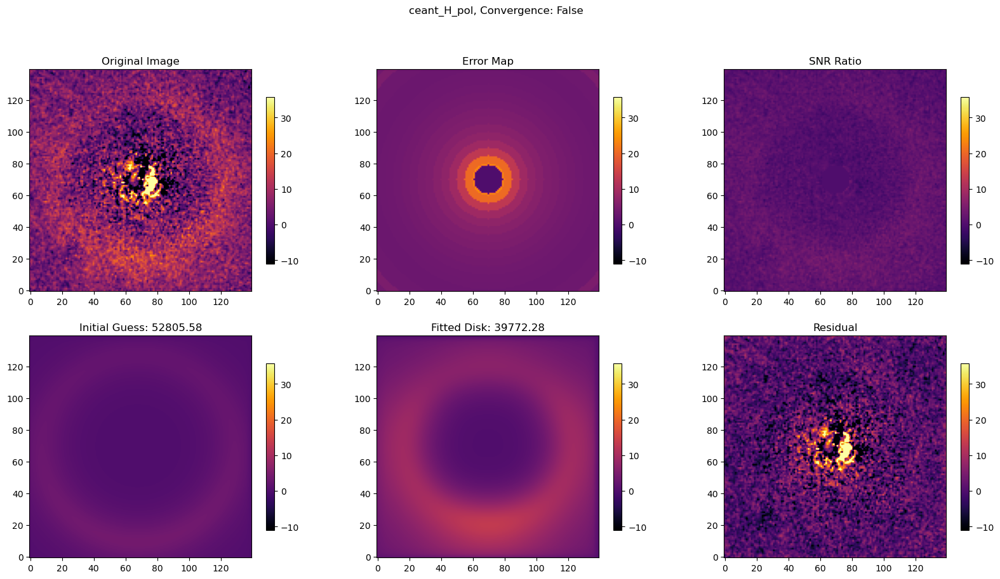

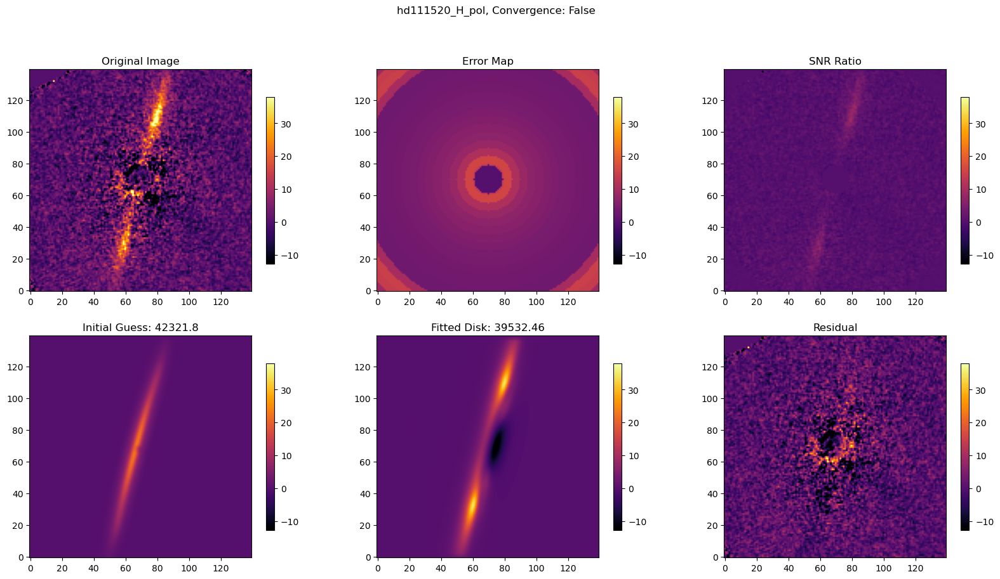

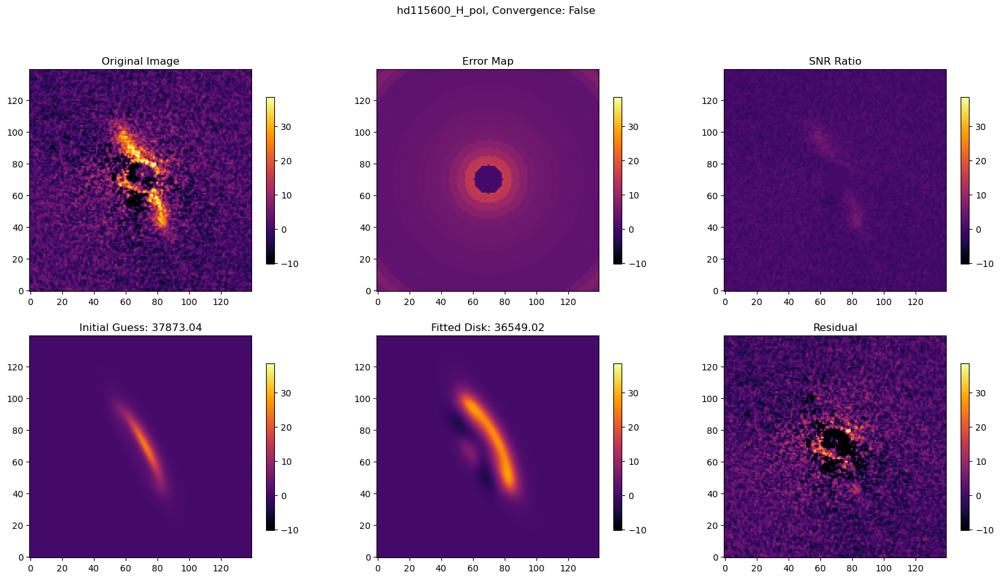

...

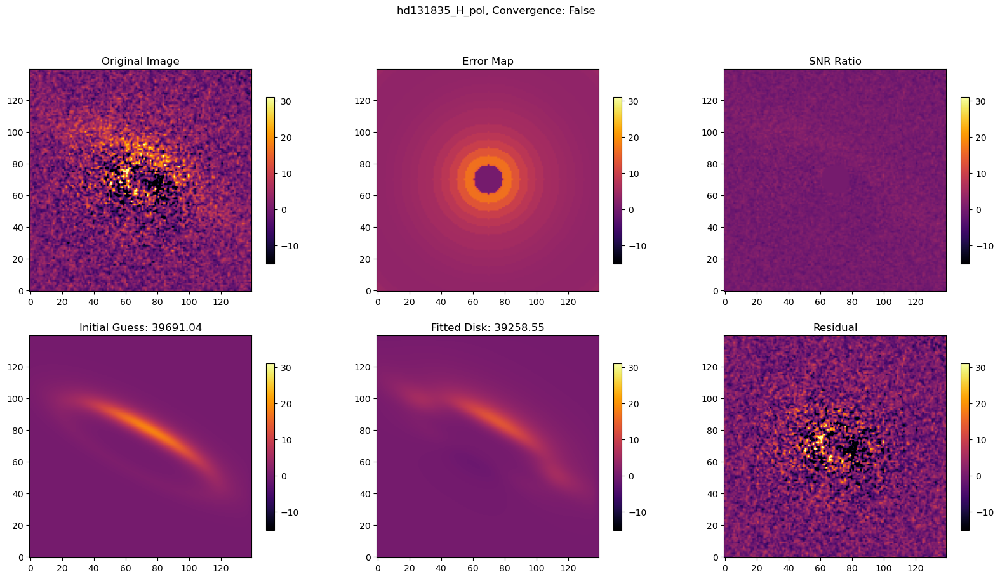

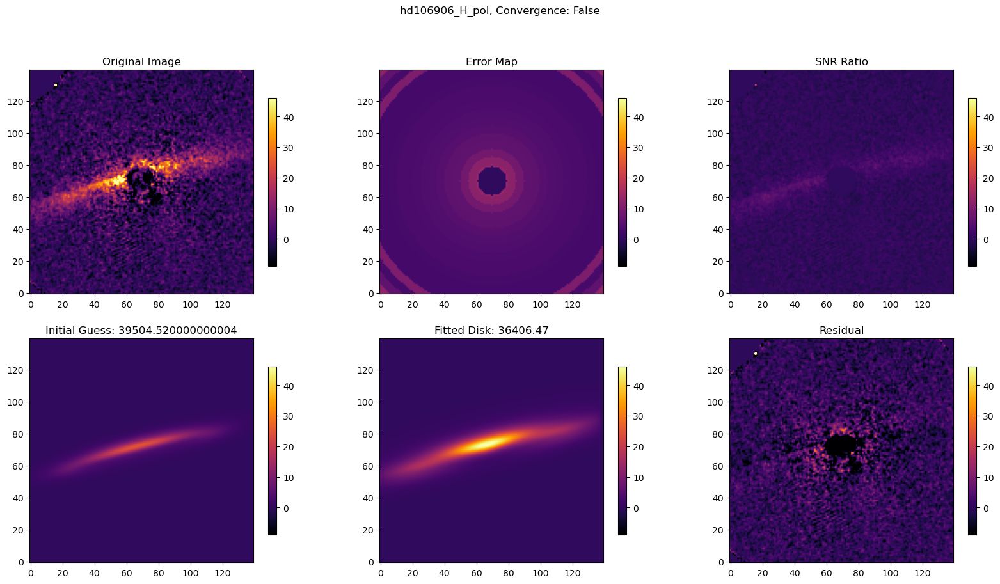

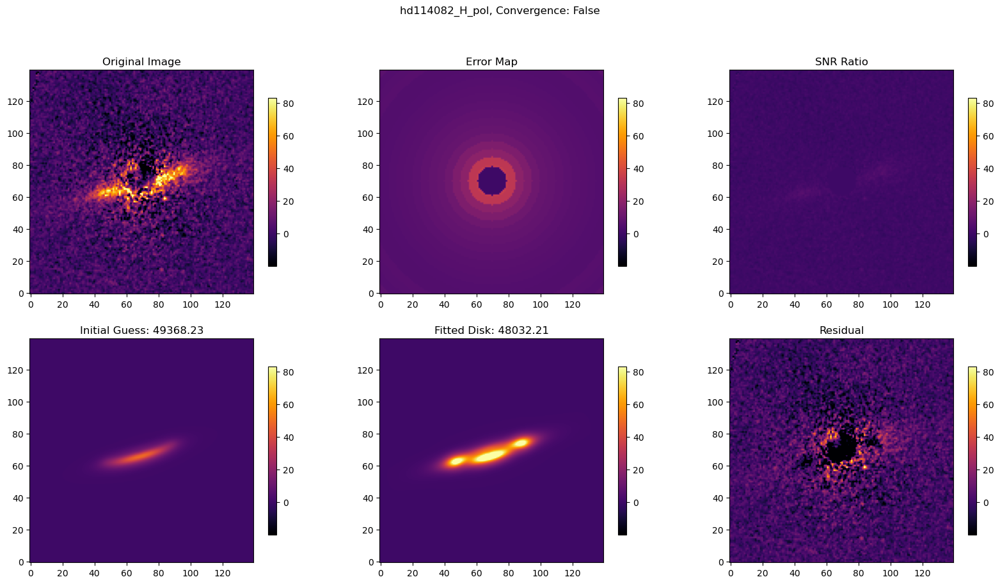

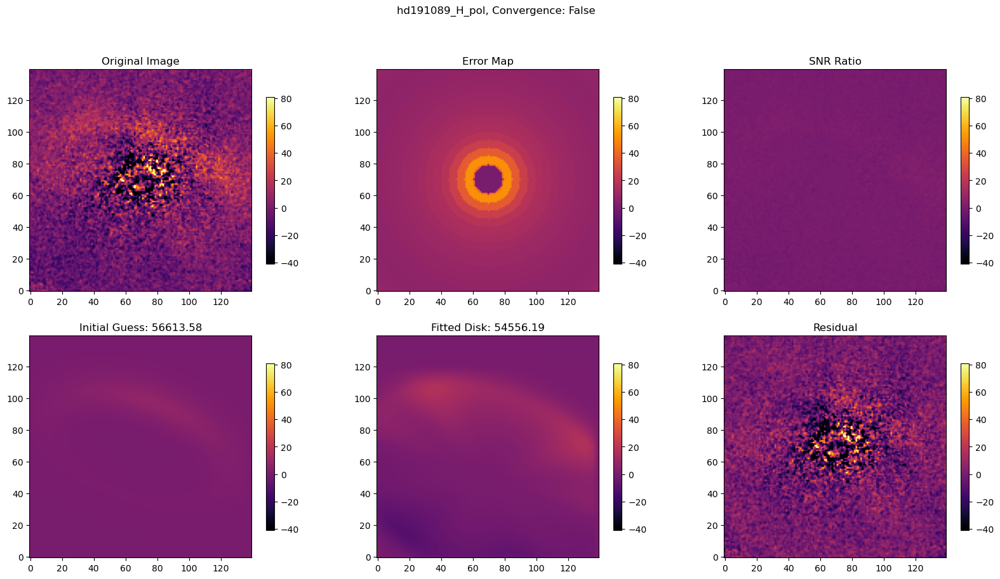

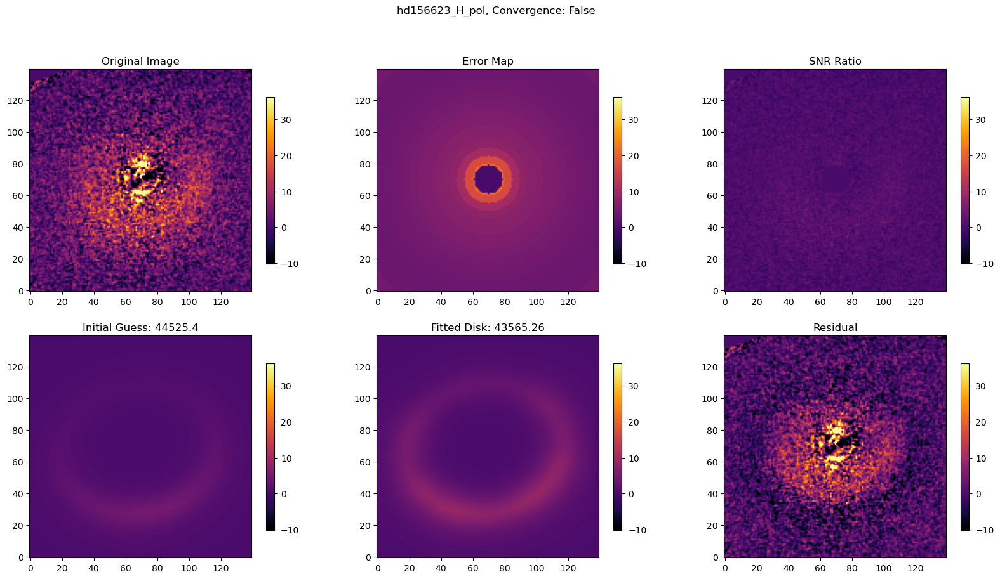

In [14]:
knot_vals = [17, 9, 11, 7, 5, 5, 11, 11, 19, 13, 5, 13, 15, 21, 15, 13, 5, 15, 13]

amnt = len(image_data)
ind = 0

data = pd.DataFrame(columns=['xc', 'yc', 'alpha_in', 'alpha_out',
                             'radius', 'inclination', 'position_angle',
                             'distance', 'knots'])

def add_row(df, name, row):
    new_row_df = pd.DataFrame([row], columns=df.columns, index=[name])
    df = pd.concat([df, new_row_df])
    df.index = df.index.astype(str)
    return df

for name, row in image_data.iterrows():
    print(row)
    hdul = fits.open("Fits/"+name+".fits")
    target_image = process_image(hdul['SCI'].data[1,:,:])
    err_map = process_image(create_empirical_err_map(hdul['SCI'].data[2,:,:])).astype(jnp.float64)
    soln = produce_image_fit(name, target_image, err_map, row["Radius"], row["Inclination"], row["Position Angle"], row["Distance"], method = None,
                             full=False, disp = False, dispTime=True,
                             knots=get_inc_bounded_knots(row["Inclination"], row["Radius"], num_knots=int(row["Knots"])))
    print(soln)
    ind+=1
    print(str(ind)+' out of '+str(amnt)+' done')
    print()
    plt.savefig("FitsResults/"+name+'.png')
    data = add_row(data, name, jnp.concatenate([soln[0:7], jnp.array([row["Distance"]]), jnp.array([row["Knots"]])]))

In [15]:
print(data)
data.to_csv('FitsResults/fits.csv')

                               xc                 yc            alpha_in  \
hd145560_H_pol  73.00039348360507  71.86171867401907   5.156956037671871   
hd146897_H_pol   71.7170754241807  72.15337424465473  2.9402452081575485   
ceant_H_pol     71.78532809354942  72.39453044284696   4.555254405236615   
hd111520_H_pol  73.00027943882255   72.7536420091311    5.86513381531303   
hd115600_H_pol  68.29823282651994  72.16240324671779   2.891712349379215   
hd129590_H_pol  70.48110529569846  72.00410336125421  3.7714021047587254   
hd117214_H_pol  69.99994437948105  70.00003520801683   4.999957233059847   
hd35841_H_pol   70.00000686746763  69.99999897261057   5.000000924254391   
hd30447_H_pol   74.32619858340463  69.61022230083334   5.497842364586343   
hd32297_H_pol    71.0384600799808  71.88061596721518   7.225749902561364   
hd110058_H_pol  69.00164943075885  73.48011465429134   2.444804662981607   
hd111161_H_pol  68.21775017951153  68.31712609377463   2.732373407904824   
hd157587_H_p

### Same Thing but with Distribution Parameters as well

In [16]:
'''data_full = pd.DataFrame(columns=['alpha_in', 'alpha_out',
                             'radius', 'inclination', 'position_angle',
                             'xc', 'yc', 'amin', 'ksi', 'gamma', 'beta',
                             'k1x', 'k2x', 'k3x', 'k4x', 'k5x', 'k6x',
                             'k1y', 'k2y', 'k3y', 'k4y', 'k5y', 'k6y'])

def add_results(df, name, soln, knots):
    rem = jnp.full(6-jnp.size(knots), jnp.nan)
    row = jnp.concatenate([soln[0:11], knots, rem, soln[11:], rem])
    new_row_df = pd.DataFrame([row], columns=df.columns, index=[name])
    df = pd.concat([df, new_row_df])
    df.index = df.index.astype(str)
    return df

ind = 0

for name, row in image_data.iterrows():
    print(row)
    hdul = fits.open("Fits/"+name+".fits")
    target_image = process_image(hdul['SCI'].data[1,:,:])
    err_map = process_image(create_empirical_err_map(hdul['SCI'].data[2,:,:]))
    soln = produce_image_fit(name, target_image, err_map, row["Radius"], row["Inclination"], row["Position Angle"], row["Distance"], full=True)#, dispTime=True)
    #print(soln)
    ind+=1
    print(str(ind)+' out of '+str(amnt)+' done')
    print()
    #plt.savefig("FitsResults/"+name+'.png')
    data_full = add_results(data_full, name, soln, get_inc_bounded_knots(row['Inclination'], row['Radius']))'''

'data_full = pd.DataFrame(columns=[\'alpha_in\', \'alpha_out\',\n                             \'radius\', \'inclination\', \'position_angle\',\n                             \'xc\', \'yc\', \'amin\', \'ksi\', \'gamma\', \'beta\',\n                             \'k1x\', \'k2x\', \'k3x\', \'k4x\', \'k5x\', \'k6x\',\n                             \'k1y\', \'k2y\', \'k3y\', \'k4y\', \'k5y\', \'k6y\'])\n\ndef add_results(df, name, soln, knots):\n    rem = jnp.full(6-jnp.size(knots), jnp.nan)\n    row = jnp.concatenate([soln[0:11], knots, rem, soln[11:], rem])\n    new_row_df = pd.DataFrame([row], columns=df.columns, index=[name])\n    df = pd.concat([df, new_row_df])\n    df.index = df.index.astype(str)\n    return df\n\nind = 0\n\nfor name, row in image_data.iterrows():\n    print(row)\n    hdul = fits.open("Fits/"+name+".fits")\n    target_image = process_image(hdul[\'SCI\'].data[1,:,:])\n    err_map = process_image(create_empirical_err_map(hdul[\'SCI\'].data[2,:,:]))\n    soln = produce_ima

In [17]:
'''print(data_full)
data_full.to_csv('fits_full.csv')'''

"print(data_full)\ndata_full.to_csv('fits_full.csv')"

### Now optimizing with spline parameters

In [18]:
'''def produce_image_fit_knots(name, target_image, err_map, radius, inclination, position_angle, distance, disp=False, dispTime=False, knots = None):

    ## Get a good scaling
    y, x = np.indices(images[3*i+j].shape)
    y -= 70
    x -= 70 
    rads = np.sqrt(x**2+y**2)
    mask = (rads > 12)

    if (knots == None):
        knots = get_inc_bounded_knots(inclination, radius, buffer = 0)

    init_disk_guess = jnp.array([5., -5., radius, inclination, position_angle])
    init_cent_guess = jnp.array([70., 70.])
    distr_guess = jnp.array([0, 3, 2, 1])
    init_knot_guess = DoubleHenyeyGreenstein_SPF.compute_phase_function_from_cosphi([0.5, 0.5, 0.5], knots)
    init_guess = jnp.concatenate([init_disk_guess, init_cent_guess, distr_guess, init_knot_guess])

    init_image = quick_image_full_opt(init_guess, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance, knots=knots)

    knot_scale = np.percentile(target_image[mask], 99) / jnp.nanmax(init_image)
    init_knot_guess = DoubleHenyeyGreenstein_SPF.compute_phase_function_from_cosphi([0.5, 0.5, 0.5], knots) * knot_scale

    init_guess = jnp.concatenate([init_disk_guess, init_cent_guess, distr_guess, init_knot_guess, knots])

    init_image = quick_image_full_opt_knots(init_guess, jnp.size(knots), PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance, knots=knots)
    init_ll = log_likelihood_image(init_image, target_image, err_map)

    # 0: alpha_in, 1: alpha_out, 2: sma, 3: inclination, 4: position_angle, 5: xc, 6: yc, 7: e, 8: ksi, 9: gamma, 10: beta
    start = datetime.now()
    soln = quick_optimize_full_opt_knots(target_image, err_map, init_params=init_guess, method = None, iters = 1000, PSFModel=EMP_PSF, pxInArcsec=0.01414, distance = distance,
                                            knots = knots, full_soln=True, disp=False)
    end = datetime.now()

    if(disp):
        print(soln)

    if(dispTime):
        print("Time taken: " + str(end-start))

    prod_image = quick_image_full_opt_knots(soln.x, jnp.size(knots), PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance)

    fig, axes = plt.subplots(2,3, figsize=(20,10))

    vmin = np.percentile(target_image[mask], 1)
    vmax = np.percentile(target_image[mask], 99.9)

    # Data
    im = axes[0][0].imshow(target_image, origin='lower', cmap='inferno')
    axes[0][0].set_title("Original Image")
    plt.colorbar(im, ax=axes[0][0], shrink=0.75)
    im.set_clim(vmin, vmax)

    # Error Map
    im = axes[0][1].imshow(err_map, origin='lower', cmap='inferno')
    axes[0][1].set_title("Error Map")
    plt.colorbar(im, ax=axes[0][1], shrink=0.75)
    im.set_clim(vmin, vmax)

    # Signal to Noise Ratio
    with np.errstate(divide='ignore', invalid='ignore'):  # Avoiding divide by 0 warnings
        snr = np.divide(target_image, err_map)
        snr[err_map == 0] = 0
    im = axes[0][2].imshow(snr, origin='lower', cmap='inferno')
    axes[0][2].set_title("SNR Ratio")
    plt.colorbar(im, ax=axes[0][2], shrink=0.75)
    im.set_clim(vmin, vmax)

    # Initial Guess
    im = axes[1][0].imshow(init_image, origin='lower', cmap='inferno')
    axes[1][0].set_title("Initial Guess: "+str(round(-init_ll, 2)))
    plt.colorbar(im, ax=axes[1][0], shrink=0.75)
    im.set_clim(vmin, vmax)

    # Fitted Disk
    im = axes[1][1].imshow(prod_image, origin='lower', cmap='inferno')
    axes[1][1].set_title("Fitted Disk: "+str(round(soln.fun, 2)))
    plt.colorbar(im, ax=axes[1][1], shrink=0.75)
    im.set_clim(vmin, vmax)

    # Residual of Fit to Data
    im = axes[1][2].imshow(target_image-prod_image, origin='lower', cmap='inferno')
    axes[1][2].set_title("Residual")
    plt.colorbar(im, ax=axes[1][2], shrink=0.75)
    im.set_clim(vmin, vmax)

    fig.suptitle(name + ", Convergence: " + str(soln.success))

    return soln.x'''

'def produce_image_fit_knots(name, target_image, err_map, radius, inclination, position_angle, distance, disp=False, dispTime=False, knots = None):\n\n    ## Get a good scaling\n    y, x = np.indices(images[3*i+j].shape)\n    y -= 70\n    x -= 70 \n    rads = np.sqrt(x**2+y**2)\n    mask = (rads > 12)\n\n    if (knots == None):\n        knots = get_inc_bounded_knots(inclination, radius, buffer = 0)\n\n    init_disk_guess = jnp.array([5., -5., radius, inclination, position_angle])\n    init_cent_guess = jnp.array([70., 70.])\n    distr_guess = jnp.array([0, 3, 2, 1])\n    init_knot_guess = DoubleHenyeyGreenstein_SPF.compute_phase_function_from_cosphi([0.5, 0.5, 0.5], knots)\n    init_guess = jnp.concatenate([init_disk_guess, init_cent_guess, distr_guess, init_knot_guess])\n\n    init_image = quick_image_full_opt(init_guess, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance, knots=knots)\n\n    knot_scale = np.percentile(target_image[mask], 99) / jnp.nanmax(init_image)\n    ini

In [19]:
'''name = image_data.index[0]
row = image_data.loc[name]

print(row)
hdul = fits.open("Fits/"+name+".fits")
target_image = process_image(hdul['SCI'].data[1,:,:])
err_map = process_image(create_empirical_err_map(hdul['SCI'].data[2,:,:], outlier_pixels=[(57, 68)]))
soln = produce_image_fit_knots(name, target_image, err_map, row["Radius"], row["Inclination"], row["Position Angle"], row["Distance"], dispTime=True)
print()
print(soln)'''

'name = image_data.index[0]\nrow = image_data.loc[name]\n\nprint(row)\nhdul = fits.open("Fits/"+name+".fits")\ntarget_image = process_image(hdul[\'SCI\'].data[1,:,:])\nerr_map = process_image(create_empirical_err_map(hdul[\'SCI\'].data[2,:,:], outlier_pixels=[(57, 68)]))\nsoln = produce_image_fit_knots(name, target_image, err_map, row["Radius"], row["Inclination"], row["Position Angle"], row["Distance"], dispTime=True)\nprint()\nprint(soln)'

### Optimizing with Eccentricity and Omega

In [20]:
from regression import log_likelihood_1d_full_opt
from disk_utils_jax import jax_model_all_1d_full
from scipy.optimize import minimize

In [37]:
def produce_image_fit_ecc(name, target_image, err_map, radius, inclination, position_angle, distance, iters = 1000, method = None, full = False,
                      disp=False, dispTime=False, knots = None, plot = True, full_soln = False, jac=None):
    opt_fun = quick_optimize_full_opt
    image_fun = quick_image_full_opt

    ## Get a good scaling
    y, x = np.indices(target_image.shape)
    y -= 70
    x -= 70 
    rads = np.sqrt(x**2+y**2)
    mask = (rads > 12)

    if (knots == None):
        knots = get_inc_bounded_knots(inclination, radius, buffer = 0)

    init_knot_guess = DoubleHenyeyGreenstein_SPF.compute_phase_function_from_cosphi([0.5, 0.5, 0.5], knots)
    init_disk_guess = jnp.array([5., -5., radius, inclination, position_angle])
    init_cent_guess = jnp.array([70., 70.])
    init_distr_guess = jnp.array([jnp.log(0.5), 50.])

    init_guess = jnp.concatenate([init_disk_guess, init_cent_guess, init_distr_guess, init_knot_guess])

    init_image = image_fun(init_guess, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance, knots=knots)

    if inclination > 70: 
        knot_scale = 1.*np.nanpercentile(target_image[mask], 99) / jnp.nanmax(init_image)
    else: 
        knot_scale = 0.2*np.nanpercentile(target_image[mask], 99) / jnp.nanmax(init_image)
        
    init_knot_guess = DoubleHenyeyGreenstein_SPF.compute_phase_function_from_cosphi([0.5, 0.5, 0.5], knots) * knot_scale
    init_guess = jnp.concatenate([init_disk_guess, init_cent_guess, init_distr_guess, init_knot_guess])
    init_image = image_fun(init_guess, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance, knots=knots)
    init_ll = log_likelihood_image(init_image, target_image, err_map)

    # 0: alpha_in, 1: alpha_out, 2: sma, 3: inclination, 4: position_angle, 5: xc, 6: yc, 7: e, 8: omega, 9: onwards is spline parameters
    start = datetime.now()
    llp = lambda x: log_likelihood_1d_full_opt(jnp.concatenate([x[0:7], jnp.exp(x[7:8]), x[8:]]),
                        DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, 
                        1e6, target_image, err_map, knots=knots, PSFModel = EMP_PSF, distance=distance, pxInArcsec=0.01414)
    #soln, ignore = jaxopt.ScipyMinimize(fun=llp, method="bfgs", maxiter=200, jit=False).run(init_params=init_guess)
    #return soln
    opt = {'disp':False,'maxiter':iters}
    soln = minimize(llp, init_guess, options=opt, method=method, jac=jac)
    end = datetime.now()

    if(disp):
        print(soln)

    if(dispTime):
        print("Time taken: " + str(end-start))

    if plot:

        cent_image = image_fun(soln.x, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance, knots=knots)

        fig, axes = plt.subplots(2,3, figsize=(20,10))

        vmin = np.nanpercentile(target_image[mask], 1)
        vmax = np.nanpercentile(target_image[mask], 99.9)

        # Data
        im = axes[0][0].imshow(target_image, origin='lower', cmap='inferno')
        axes[0][0].set_title("Original Image")
        plt.colorbar(im, ax=axes[0][0], shrink=0.75)
        im.set_clim(vmin, vmax)

        # Error Map
        im = axes[0][1].imshow(err_map, origin='lower', cmap='inferno')
        axes[0][1].set_title("Error Map")
        plt.colorbar(im, ax=axes[0][1], shrink=0.75)
        im.set_clim(vmin, vmax)

        # Signal to Noise Ratio
        with np.errstate(divide='ignore', invalid='ignore'):  # Avoiding divide by 0 warnings
            snr = np.divide(target_image, err_map)
            snr[err_map == 0] = 0
        im = axes[0][2].imshow(snr, origin='lower', cmap='inferno')
        axes[0][2].set_title("SNR Ratio")
        plt.colorbar(im, ax=axes[0][2], shrink=0.75)
        im.set_clim(vmin, vmax)

        # Initial Guess
        im = axes[1][0].imshow(init_image, origin='lower', cmap='inferno')
        axes[1][0].set_title("Initial Guess: "+str(round(-init_ll, 2)))
        plt.colorbar(im, ax=axes[1][0], shrink=0.75)
        im.set_clim(vmin, vmax)

        # Fitted Disk
        im = axes[1][1].imshow(cent_image, origin='lower', cmap='inferno')
        axes[1][1].set_title("Fitted Disk: "+str(round(soln.fun, 2)))
        plt.colorbar(im, ax=axes[1][1], shrink=0.75)
        im.set_clim(vmin, vmax)

        # Residual of Fit to Data
        im = axes[1][2].imshow(target_image-cent_image, origin='lower', cmap='inferno')
        axes[1][2].set_title("Residual")
        plt.colorbar(im, ax=axes[1][2], shrink=0.75)
        im.set_clim(vmin, vmax)

        fig.suptitle(name + ", Convergence: " + str(soln.success))

    if full_soln:
        return soln

    return soln.x

In [22]:
jax.config.update("jax_debug_nans", True)

'''from regression import log_likelihood_1d_full_opt

knots = jnp.linspace(1, -1, 6)
init_knot_guess = DoubleHenyeyGreenstein_SPF.compute_phase_function_from_cosphi([0.5, 0.5, 0.5], knots)
init_disk_guess = jnp.array([5., -5., 50, 50, 50])
init_cent_guess = jnp.array([70., 70.])
init_distr_guess = jnp.array([0.1, 0.])
init_guess = jnp.concatenate([init_disk_guess, init_cent_guess, init_distr_guess, init_knot_guess])

llp = lambda x: log_likelihood_1d_full_opt(x, DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, 1e6, target_image, err_map,
                                               knots = jnp.linspace(1,-1,6), PSFModel = GAUSSIAN_PSF)

grad_func = jax.grad(llp)
print(grad_func(init_guess))'''

'from regression import log_likelihood_1d_full_opt\n\nknots = jnp.linspace(1, -1, 6)\ninit_knot_guess = DoubleHenyeyGreenstein_SPF.compute_phase_function_from_cosphi([0.5, 0.5, 0.5], knots)\ninit_disk_guess = jnp.array([5., -5., 50, 50, 50])\ninit_cent_guess = jnp.array([70., 70.])\ninit_distr_guess = jnp.array([0.1, 0.])\ninit_guess = jnp.concatenate([init_disk_guess, init_cent_guess, init_distr_guess, init_knot_guess])\n\nllp = lambda x: log_likelihood_1d_full_opt(x, DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, 1e6, target_image, err_map,\n                                               knots = jnp.linspace(1,-1,6), PSFModel = GAUSSIAN_PSF)\n\ngrad_func = jax.grad(llp)\nprint(grad_func(init_guess))'

Radius             81.00
Inclination        88.00
Position Angle    165.00
Distance          108.94
Knots               7.00
Name: hd111520_H_pol, dtype: float64


  message: Desired error not necessarily achieved due to precision loss.
  success: False
   status: 2
      fun: 39894.644161837336
        x: [ 7.000e+01  7.000e+01 ...  2.985e-03 -8.327e-04]
      nit: 5
      jac: [-1.553e+02 -5.495e+01 ...  2.349e+03  6.724e+03]
 hess_inv: [[ 1.021e+00  6.697e-03 ...  7.473e-02  5.015e-02]
            [ 6.697e-03  1.002e+00 ...  2.474e-02  1.609e-02]
            ...
            [ 7.473e-02  2.474e-02 ...  3.060e-01  9.742e-02]
            [ 5.015e-02  1.609e-02 ...  9.742e-02  4.888e-01]]
     nfev: 1216
     njev: 86
Time taken: 0:00:14.828575



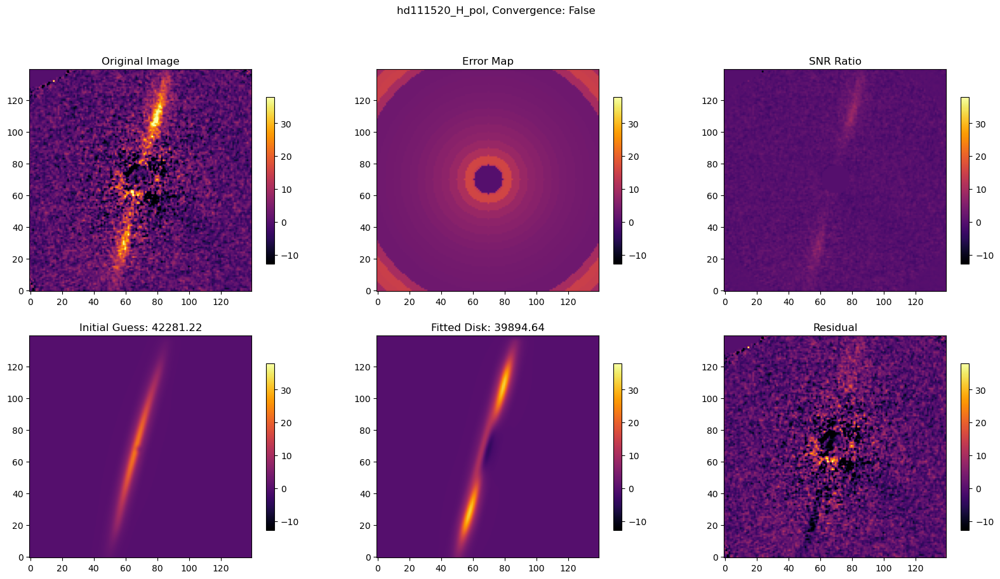

In [35]:
# name = image_data.index[5]
name = "hd111520_H_pol"
# name = "hr4796a_H_pol"
row = image_data.loc[name]

hdul = fits.open("Fits/"+name+".fits")
target_image = process_image(hdul['SCI'].data[1,:,:])
err_map = process_image(create_empirical_err_map(hdul['SCI'].data[2,:,:])).astype(jnp.float64) #, outlier_pixels=[(57, 68)]))
print(row)
soln = produce_image_fit(name, target_image, err_map, row["Radius"], row["Inclination"], row["Position Angle"], row["Distance"],
                         disp=True, iters=1000, method = None, dispTime=True,
                         knots=get_inc_bounded_knots(row["Inclination"], row["Radius"], int(row["Knots"])))
print()

In [39]:
# name = image_data.index[5]
name = "hd111520_H_pol"
# name = "hr4796a_H_pol"
row = image_data.loc[name]


llp = lambda x: log_likelihood_1d_full_opt(jnp.concatenate([x[0:7], jnp.exp(x[7:8]), x[8:]]),
                        DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, 
                        1e6, target_image, err_map, knots=get_inc_bounded_knots(row["Inclination"], row["Radius"], int(row["Knots"])),
                        PSFModel = EMP_PSF, distance=row["Distance"], pxInArcsec=0.01414)
grad_func = jax.grad(llp)


hdul = fits.open("Fits/"+name+".fits")
target_image = process_image(hdul['SCI'].data[1,:,:])
err_map = process_image(create_empirical_err_map(hdul['SCI'].data[2,:,:])).astype(jnp.float64) #, outlier_pixels=[(57, 68)]))
print(row)
soln = produce_image_fit_ecc(name, target_image, err_map, row["Radius"], row["Inclination"], row["Position Angle"], row["Distance"],
                         disp=True, iters=1000, method = "Newton-CG", dispTime=True,
                         knots=get_inc_bounded_knots(row["Inclination"], row["Radius"], int(row["Knots"])),
                         jac = grad_func)
print()

In [29]:
print(jnp.concatenate([soln[0:7], jnp.exp(soln[7:8]), soln[8:]]))

[ 1.32503374e+03 -1.89340859e+00  7.24292202e+01  8.85981361e+01
  1.65572902e+02  7.29998603e+01  7.72250501e+01  3.70885773e-01
  6.38084005e+01  1.67798440e-03  3.95098163e-05 -9.94981421e-05
  2.00102685e-03  1.10311809e-03  7.41183770e-05]


[ 1.32503374e+03 -1.89340859e+00  7.24292202e+01  8.85981361e+01
  1.65572902e+02  7.29998603e+01  7.72250501e+01  0.00000000e+00
  6.38084005e+01  1.67798440e-03  3.95098163e-05 -9.94981421e-05
  2.00102685e-03  1.10311809e-03  7.41183770e-05]


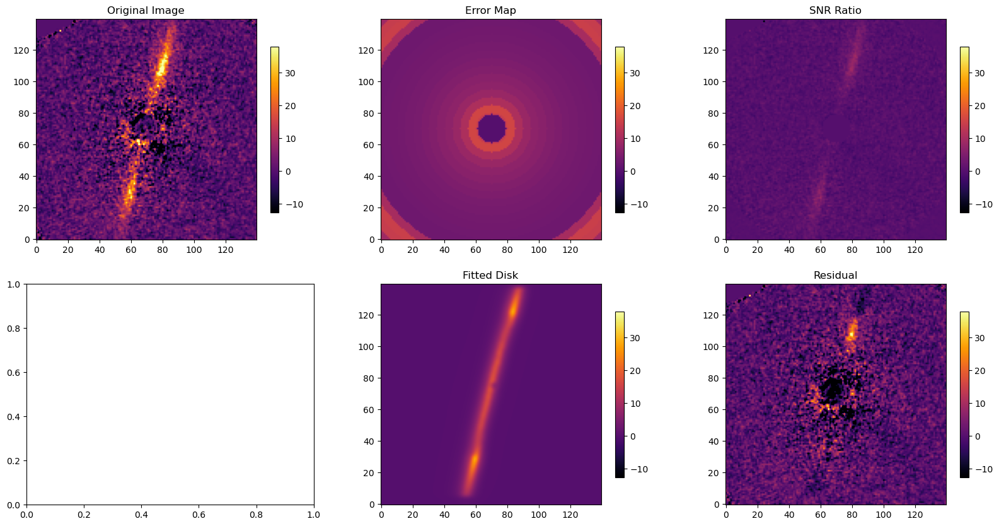

In [30]:
# 0: alpha_in, 1: alpha_out, 2: sma, 3: inclination, 4: position_angle, 5: xc, 6: yc, 7: e, 8: omega, 9: onwards is spline parameters

soln[7] = 0.
print(soln)

cent_image = quick_image_full_opt(soln, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = row["Distance"],
                                   knots=get_inc_bounded_knots(row["Inclination"], row["Radius"], int(row["Knots"])))

fig, axes = plt.subplots(2,3, figsize=(20,10))

vmin = np.nanpercentile(target_image[mask], 1)
vmax = np.nanpercentile(target_image[mask], 99.9)

# Data
im = axes[0][0].imshow(target_image, origin='lower', cmap='inferno')
axes[0][0].set_title("Original Image")
plt.colorbar(im, ax=axes[0][0], shrink=0.75)
im.set_clim(vmin, vmax)

# Error Map
im = axes[0][1].imshow(err_map, origin='lower', cmap='inferno')
axes[0][1].set_title("Error Map")
plt.colorbar(im, ax=axes[0][1], shrink=0.75)
im.set_clim(vmin, vmax)

# Signal to Noise Ratio
with np.errstate(divide='ignore', invalid='ignore'):  # Avoiding divide by 0 warnings
    snr = np.divide(target_image, err_map)
    snr[err_map == 0] = 0
im = axes[0][2].imshow(snr, origin='lower', cmap='inferno')
axes[0][2].set_title("SNR Ratio")
plt.colorbar(im, ax=axes[0][2], shrink=0.75)
im.set_clim(vmin, vmax)

# Fitted Disk
im = axes[1][1].imshow(cent_image, origin='lower', cmap='inferno')
axes[1][1].set_title("Fitted Disk")
plt.colorbar(im, ax=axes[1][1], shrink=0.75)
im.set_clim(vmin, vmax)

# Residual of Fit to Data
im = axes[1][2].imshow(target_image-cent_image, origin='lower', cmap='inferno')
axes[1][2].set_title("Residual")
plt.colorbar(im, ax=axes[1][2], shrink=0.75)
im.set_clim(vmin, vmax)

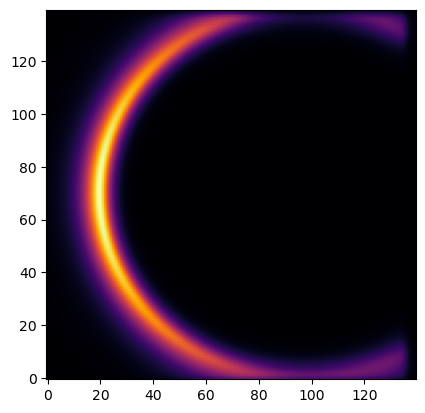

In [27]:
from disk_utils_jax import jax_model_all_1d_full

# 0: alpha_in, 1: alpha_out, 2: sma, 3: inclination, 4: position_angle, 5: xc, 6: yc, 7: e, 8: omega, 9: onwards is spline parameters

soln[3] = 0
soln[7] = 0.4
soln[8] = 180
soln[4] = 90

knots=get_inc_bounded_knots(row["Inclination"], row["Radius"], int(row["Knots"]))

model_image = jax_model_all_1d_full(DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, soln[0:9], 
                                        InterpolatedUnivariateSpline_SPF.pack_pars(soln[9:], knots=knots), 1e6, PSFModel=EMP_PSF,
                                        pxInArcsec=0.01414, distance = row["Distance"])

plt.imshow(model_image, cmap='inferno', origin='lower')